## EDA ARIZONA HOUSING DATA

This is the first asssignment to work on. The goal is to clean a given data set and prepare it to be handled over to the modeling team to manipulate it. The business problem isn't defined, but after examining the data we can make an assumption that it might be used to predict the housing prices in the future. According to the zip-codes and latitiudes-longitudes coordinates, the data was obtained from Arizona. 

The first step in the workflow was to import numpy, pandas, matplotlib and seaborn libraries to use them in later stages. After that the data was uploaded from its path in the system using the pandas commnad pd.read_csv, whihc reads a csv file and upload it to the notebook. After that a dataframe was created in order to use it with pandas and numpy commands. 

After taking a first look at the data we can seee that we have a matrix with dimensions (5000x16) and each column represents a specific property. 

Used prompts like df.info, df.size, df.head, df.tail to get a glimpse of the data. 

To clean the data, the goal was to identify missing and not available entries. In that case, we will primarily identify rows with the following criteria: none, n/a, null, etc. to do that we used the function (isnull) but it didn't return all missing values. it showed only that we have 4990 non null objects in the column (lot_acres), in other words, we have 10 null objects we need to take care of. However, the (isnull) command failed to identify or capture other missing rows such as (none, n/a, N/a), so we had to use another command to capture the rest of the missing data. 

To do that, we used the drop function and applied it on every column

For the MLS column, nothing was ommmitted or altered. They are sequential values; they might be important and might not be. They could imply when the property was built, so that's why they weren't ommitted. 

We realized that the zipcodes are in AZ with close proximities to each other, so we got rid of the latitude and longitude. For sold price, the max value is (5.3e6) and the min is (169k). They could have been delted from the df, but decided not to do that. Left for the DS to decide. 

lot_acres had some null values so we eliminated them, and whenever any none value was present, it was replaced with 0. 

For taxes, some rows had zero, which doesn't make sense so they got deleted. for entries that had none, they were replaced by the median.

For the year built, some rows had year=0 whihc is obviosly not possibl so we had to delete those entries. 

For bedrooms, bathrooms, and sqrt_ft: dropped none and zeros. For garage, dropped none. 

For kitchen features and floor covering, had two thoughts. one is to just keep them as they are (strings). however, at some point we have to convert them to numerical values, do encoding. This is left as an execise for the data scientist. the other idea is just to encode them and change them from strings to numerical variables and explain to the DS what encoding process has been used. but in this exercise, they were just dropped because they don't seem to have any a correlation to the sold price.

For HOA, replaced non with zero. 

For all rows that had na as entries, they were replaced with the median. 

There is no strong correlation between the varibles in the data, although there is some relation between the number of bedrooms/ bathrooms, lot acres and sold price. Surprisingly, there is no dependency between the sold price and taxes. A possible reason is that property taxes are subject to annual changes and a higher property price doesn't necessarily mean a higher property tax amount. 

In [169]:
import numpy as np
import pandas as pd
import matplotlib 
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

In [170]:
data = pd.read_csv(r'C:\Users\Field Employee\Downloads\raw_house_data.csv')
df=data

In [171]:
data.head()

,MLS,sold_price,zipcode,longitude,latitude,lot_acres,taxes,year_built,bedrooms,bathrooms,sqrt_ft,garage,kitchen_features,fireplaces,floor_covering,HOA
0,21530491,5300000.0,85637,-110.378200,31.356362,2154.00,5272.00,1941,13,10,10500,0,"Dishwasher, Freezer, Refrigerator, Oven",6,"Mexican Tile, Wood",0
1,21529082,4200000.0,85646,-111.045371,31.594213,1707.00,10422.36,1997,2,2,7300,0,"Dishwasher, Garbage Disposal",5,"Natural Stone, Other",0
2,3054672,4200000.0,85646,-111.040707,31.594844,1707.00,10482.00,1997,2,3,None,None,"Dishwasher, Garbage Disposal, Refrigerator",5,"Natural Stone, Other: Rock",None
3,21919321,4500000.0,85646,-111.035925,31.645878,636.67,8418.58,1930,7,5,9019,4,"Dishwasher, Double Sink, Pantry: Butler, Refri...",4,"Ceramic Tile, Laminate, Wood",None
4,21306357,3411450.0,85750,-110.813768,32.285162,3.21,15393.00,1995,4,6,6396,3,"Dishwasher, Garbage Disposal, Refrigerator, Mi...",5,"Carpet, Concrete",55


In [172]:
data.size

80000

In [6]:
df.describe()

,MLS,sold_price,zipcode,longitude,latitude,lot_acres,taxes,year_built,bedrooms
count,5.000000e+03,5.000000e+03,5000.000000,5000.000000,5000.000000,4990.000000,5.000000e+03,5000.00000,5000.000000
mean,2.127070e+07,7.746262e+05,85723.025600,-110.912107,32.308512,4.661317,9.402828e+03,1992.32800,3.933800
std,2.398508e+06,3.185556e+05,38.061712,0.120629,0.178028,51.685230,1.729385e+05,65.48614,1.245362
min,3.042851e+06,1.690000e+05,85118.000000,-112.520168,31.356362,0.000000,0.000000e+00,0.00000,1.000000
25%,2.140718e+07,5.850000e+05,85718.000000,-110.979260,32.277484,0.580000,4.803605e+03,1987.00000,3.000000
50%,2.161469e+07,6.750000e+05,85737.000000,-110.923420,32.318517,0.990000,6.223760e+03,1999.00000,4.000000
75%,2.180480e+07,8.350000e+05,85749.000000,-110.859078,32.394334,1.757500,8.082830e+03,2006.00000,4.000000
max,2.192856e+07,5.300000e+06,86323.000000,-109.454637,34.927884,2154.000000,1.221508e+07,2019.00000,36.000000


In [7]:
df.head()

,MLS,sold_price,zipcode,longitude,latitude,lot_acres,taxes,year_built,bedrooms,bathrooms,sqrt_ft,garage,kitchen_features,fireplaces,floor_covering,HOA
0,21530491,5300000.0,85637,-110.378200,31.356362,2154.00,5272.00,1941,13,10,10500,0,"Dishwasher, Freezer, Refrigerator, Oven",6,"Mexican Tile, Wood",0
1,21529082,4200000.0,85646,-111.045371,31.594213,1707.00,10422.36,1997,2,2,7300,0,"Dishwasher, Garbage Disposal",5,"Natural Stone, Other",0
2,3054672,4200000.0,85646,-111.040707,31.594844,1707.00,10482.00,1997,2,3,None,None,"Dishwasher, Garbage Disposal, Refrigerator",5,"Natural Stone, Other: Rock",None
3,21919321,4500000.0,85646,-111.035925,31.645878,636.67,8418.58,1930,7,5,9019,4,"Dishwasher, Double Sink, Pantry: Butler, Refri...",4,"Ceramic Tile, Laminate, Wood",None
4,21306357,3411450.0,85750,-110.813768,32.285162,3.21,15393.00,1995,4,6,6396,3,"Dishwasher, Garbage Disposal, Refrigerator, Mi...",5,"Carpet, Concrete",55


In [8]:
df.tail()

,MLS,sold_price,zipcode,longitude,latitude,lot_acres,taxes,year_built,bedrooms,bathrooms,sqrt_ft,garage,kitchen_features,fireplaces,floor_covering,HOA
4995,21810382,495000.0,85641,-110.661829,31.907917,4.98,2017.00,2005,5,3,3601,3,"Dishwasher, Double Sink, Garbage Disposal, Gas...",1,"Carpet, Ceramic Tile",None
4996,21908591,550000.0,85750,-110.858556,32.316373,1.42,4822.01,1990,4,3,2318,3,"Dishwasher, Double Sink, Electric Range, Garba...",1,"Carpet, Ceramic Tile",43
4997,21832452,475000.0,85192,-110.755428,32.964708,12.06,1000.00,1969,3,2,1772,0,"Dishwasher, Electric Range, Island, Refrigerat...",0,Ceramic Tile,None
4998,21900515,550000.0,85745,-111.055528,32.296871,1.01,5822.93,2009,4,4,3724,3,"Dishwasher, Double Sink, Garbage Disposal, Gas...",1,"Carpet, Ceramic Tile",None
4999,4111490,450000.0,85621,-110.913054,31.385259,4.16,2814.48,1988,4,4,4317,None,"Compactor, Dishwasher, Double Sink, Island, Ap...",3,"Carpet, Mexican Tile",None


In [12]:
len(df)

5000

In [13]:
df.shape

(5000, 16)

In [14]:
df.size

80000

In [16]:
df.ndim

2

In [22]:
df.isnull().any().any()

True

In [23]:
nan_rows = df[df.isnull().any(1)]

In [24]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 16 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   MLS               5000 non-null   int64  
 1   sold_price        5000 non-null   float64
 2   zipcode           5000 non-null   int64  
 3   longitude         5000 non-null   float64
 4   latitude          5000 non-null   float64
 5   lot_acres         4990 non-null   float64
 6   taxes             5000 non-null   float64
 7   year_built        5000 non-null   int64  
 8   bedrooms          5000 non-null   int64  
 9   bathrooms         5000 non-null   object 
 10  sqrt_ft           5000 non-null   object 
 11  garage            5000 non-null   object 
 12  kitchen_features  5000 non-null   object 
 13  fireplaces        5000 non-null   object 
 14  floor_covering    5000 non-null   object 
 15  HOA               5000 non-null   object 
dtypes: float64(5), int64(4), object(7)
memory 

In [25]:
# extract the null values 

In [42]:
missing_acres=pd.isnull(df['lot_acres'])
df[missing_acres]

,MLS,sold_price,zipcode,longitude,latitude,lot_acres,taxes,year_built,bedrooms,bathrooms,sqrt_ft,garage,kitchen_features,fireplaces,floor_covering,HOA
967,3058213,695000.0,85645,-111.183593,31.702330,NaN,2480.58,1932,4,4,None,2,"Dishwasher, Double Sink, Gas Range, Refrigerat...",,Ceramic Tile,None
1659,3055188,700000.0,85646,-111.046366,31.623839,NaN,6740.66,2007,3,4,None,3,"Dishwasher, Double Sink, Freezer, Garbage Disp...",,Natural Stone,157
2564,3051223,680000.0,85622,-111.000925,31.836922,NaN,4158.40,2007,3,4,None,3,"Dishwasher, Double Sink, Garbage Disposal, Gas...",1,"Carpet, Ceramic Tile",100
2939,3060029,655000.0,85614,-110.971212,31.835117,NaN,6433.00,2001,3,4,None,3,"Dishwasher, Double Sink, Electric Range, Garba...",,"Carpet, Ceramic Tile",83.33
3420,3059875,605000.0,85622,-111.009941,31.839620,NaN,6134.56,2012,4,4,None,2,"Compactor, Dishwasher, Double Sink, Garbage Di...",,"Carpet, Ceramic Tile",85
3530,3050480,580000.0,85622,-111.007069,31.846199,NaN,4498.01,1987,3,3,None,5,"Dishwasher, Double Sink, Electric Range, Garba...",1,"Carpet, Mexican Tile",None
4173,3059167,550000.0,85614,-110.940656,31.878329,NaN,5630.10,2013,3,4,None,3,"Dishwasher, Double Sink, Electric Range, Garba...",,"Carpet, Ceramic Tile",158
4286,3050688,584165.0,85622,-111.039164,31.790671,NaN,653.47,2012,2,2,None,3,"Dishwasher, Double Sink, Pantry: Closet, Count...",,Ceramic Tile,None
4365,3053499,545000.0,85614,-110.978688,31.832598,NaN,4817.00,2001,3,3,None,3,"Dishwasher, Double Sink, Garbage Disposal, Gas...",,"Carpet, Other: Travertine",33.33
4783,3058623,530000.0,85622,-111.009020,31.839576,NaN,5264.34,2009,3,4,None,2,"Dishwasher, Double Sink, Garbage Disposal, Gas...",,Ceramic Tile,85


In [28]:
lot_acres.head()

0    False
1    False
2    False
3    False
4    False
Name: lot_acres, dtype: bool

In [29]:
lot_acres.size

5000

In [33]:
lot_acres.shape

(5000,)

In [35]:
lot_acres

0       False
1       False
2       False
3       False
4       False
        ...  
4995    False
4996    False
4997    False
4998    False
4999    False
Name: lot_acres, Length: 5000, dtype: bool

In [40]:
df2

[0       False
 1       False
 2       False
 3       False
 4       False
         ...  
 4995    False
 4996    False
 4997    False
 4998    False
 4999    False
 Name: lot_acres, Length: 5000, dtype: bool]

In [43]:
df.head()

,MLS,sold_price,zipcode,longitude,latitude,lot_acres,taxes,year_built,bedrooms,bathrooms,sqrt_ft,garage,kitchen_features,fireplaces,floor_covering,HOA
0,21530491,5300000.0,85637,-110.378200,31.356362,2154.00,5272.00,1941,13,10,10500,0,"Dishwasher, Freezer, Refrigerator, Oven",6,"Mexican Tile, Wood",0
1,21529082,4200000.0,85646,-111.045371,31.594213,1707.00,10422.36,1997,2,2,7300,0,"Dishwasher, Garbage Disposal",5,"Natural Stone, Other",0
2,3054672,4200000.0,85646,-111.040707,31.594844,1707.00,10482.00,1997,2,3,None,None,"Dishwasher, Garbage Disposal, Refrigerator",5,"Natural Stone, Other: Rock",None
3,21919321,4500000.0,85646,-111.035925,31.645878,636.67,8418.58,1930,7,5,9019,4,"Dishwasher, Double Sink, Pantry: Butler, Refri...",4,"Ceramic Tile, Laminate, Wood",None
4,21306357,3411450.0,85750,-110.813768,32.285162,3.21,15393.00,1995,4,6,6396,3,"Dishwasher, Garbage Disposal, Refrigerator, Mi...",5,"Carpet, Concrete",55


In [44]:
df.tail()

,MLS,sold_price,zipcode,longitude,latitude,lot_acres,taxes,year_built,bedrooms,bathrooms,sqrt_ft,garage,kitchen_features,fireplaces,floor_covering,HOA
4995,21810382,495000.0,85641,-110.661829,31.907917,4.98,2017.00,2005,5,3,3601,3,"Dishwasher, Double Sink, Garbage Disposal, Gas...",1,"Carpet, Ceramic Tile",None
4996,21908591,550000.0,85750,-110.858556,32.316373,1.42,4822.01,1990,4,3,2318,3,"Dishwasher, Double Sink, Electric Range, Garba...",1,"Carpet, Ceramic Tile",43
4997,21832452,475000.0,85192,-110.755428,32.964708,12.06,1000.00,1969,3,2,1772,0,"Dishwasher, Electric Range, Island, Refrigerat...",0,Ceramic Tile,None
4998,21900515,550000.0,85745,-111.055528,32.296871,1.01,5822.93,2009,4,4,3724,3,"Dishwasher, Double Sink, Garbage Disposal, Gas...",1,"Carpet, Ceramic Tile",None
4999,4111490,450000.0,85621,-110.913054,31.385259,4.16,2814.48,1988,4,4,4317,None,"Compactor, Dishwasher, Double Sink, Island, Ap...",3,"Carpet, Mexican Tile",None


In [45]:
df[missing_acres]

,MLS,sold_price,zipcode,longitude,latitude,lot_acres,taxes,year_built,bedrooms,bathrooms,sqrt_ft,garage,kitchen_features,fireplaces,floor_covering,HOA
967,3058213,695000.0,85645,-111.183593,31.702330,NaN,2480.58,1932,4,4,None,2,"Dishwasher, Double Sink, Gas Range, Refrigerat...",,Ceramic Tile,None
1659,3055188,700000.0,85646,-111.046366,31.623839,NaN,6740.66,2007,3,4,None,3,"Dishwasher, Double Sink, Freezer, Garbage Disp...",,Natural Stone,157
2564,3051223,680000.0,85622,-111.000925,31.836922,NaN,4158.40,2007,3,4,None,3,"Dishwasher, Double Sink, Garbage Disposal, Gas...",1,"Carpet, Ceramic Tile",100
2939,3060029,655000.0,85614,-110.971212,31.835117,NaN,6433.00,2001,3,4,None,3,"Dishwasher, Double Sink, Electric Range, Garba...",,"Carpet, Ceramic Tile",83.33
3420,3059875,605000.0,85622,-111.009941,31.839620,NaN,6134.56,2012,4,4,None,2,"Compactor, Dishwasher, Double Sink, Garbage Di...",,"Carpet, Ceramic Tile",85
3530,3050480,580000.0,85622,-111.007069,31.846199,NaN,4498.01,1987,3,3,None,5,"Dishwasher, Double Sink, Electric Range, Garba...",1,"Carpet, Mexican Tile",None
4173,3059167,550000.0,85614,-110.940656,31.878329,NaN,5630.10,2013,3,4,None,3,"Dishwasher, Double Sink, Electric Range, Garba...",,"Carpet, Ceramic Tile",158
4286,3050688,584165.0,85622,-111.039164,31.790671,NaN,653.47,2012,2,2,None,3,"Dishwasher, Double Sink, Pantry: Closet, Count...",,Ceramic Tile,None
4365,3053499,545000.0,85614,-110.978688,31.832598,NaN,4817.00,2001,3,3,None,3,"Dishwasher, Double Sink, Garbage Disposal, Gas...",,"Carpet, Other: Travertine",33.33
4783,3058623,530000.0,85622,-111.009020,31.839576,NaN,5264.34,2009,3,4,None,2,"Dishwasher, Double Sink, Garbage Disposal, Gas...",,Ceramic Tile,85


In [50]:
for col in df:
    print(df[col].unique())
    print(col)

[21530491 21529082  3054672 ... 21832452 21900515  4111490]
MLS
[5300000. 4200000. 4500000. ...  539100.  534000.  526710.]
sold_price
[85637 85646 85750 85718 85712 85640 85658 85739 85609 85755 86024 85749
 85715 85624 85745 85742 85648 85716 85701 85719 85641 85737 85705 85743
 85748 85611 85704 85747 85614 85603 85645 85602 85621 85610 85615 85623
 85622 85730 85619 85629 85630 85710 85643 86323 85118 85605 85929 85711
 85541 85713 85625 85935 85601 85901 85638 85192]
zipcode
[-110.3782   -111.045371 -111.040707 ... -110.755428 -111.055528
 -110.913054]
longitude
[31.356362 31.594213 31.594844 ... 32.964708 32.296871 31.385259]
latitude
[2.15400e+03 1.70700e+03 6.36670e+02 3.21000e+00 1.67000e+00 2.10000e+00
 1.07000e+00 6.73000e+00 3.53000e+00 1.47180e+02 1.65000e+00 2.96000e+01
 1.82000e+00 0.00000e+00 3.10000e+00 1.25000e+00 9.30000e+01 6.40000e-01
 3.42000e+00 1.31600e+01 2.84000e+00 1.50000e-01 1.30000e+01 1.27000e+00
 1.04818e+03 1.55000e+00 1.01000e+00 1.16000e+00 3.22000e+0

In [51]:
df.sold_price.unique()

array([5300000., 4200000., 4500000., ...,  539100.,  534000.,  526710.])

In [54]:
df.describe

<bound method NDFrame.describe of            MLS  sold_price  zipcode   longitude   latitude  lot_acres  \
0     21530491   5300000.0    85637 -110.378200  31.356362    2154.00   
1     21529082   4200000.0    85646 -111.045371  31.594213    1707.00   
2      3054672   4200000.0    85646 -111.040707  31.594844    1707.00   
3     21919321   4500000.0    85646 -111.035925  31.645878     636.67   
4     21306357   3411450.0    85750 -110.813768  32.285162       3.21   
...        ...         ...      ...         ...        ...        ...   
4995  21810382    495000.0    85641 -110.661829  31.907917       4.98   
4996  21908591    550000.0    85750 -110.858556  32.316373       1.42   
4997  21832452    475000.0    85192 -110.755428  32.964708      12.06   
4998  21900515    550000.0    85745 -111.055528  32.296871       1.01   
4999   4111490    450000.0    85621 -110.913054  31.385259       4.16   

         taxes  year_built  bedrooms bathrooms sqrt_ft garage  \
0      5272.00        19

In [55]:
df.isna

<bound method DataFrame.isna of            MLS  sold_price  zipcode   longitude   latitude  lot_acres  \
0     21530491   5300000.0    85637 -110.378200  31.356362    2154.00   
1     21529082   4200000.0    85646 -111.045371  31.594213    1707.00   
2      3054672   4200000.0    85646 -111.040707  31.594844    1707.00   
3     21919321   4500000.0    85646 -111.035925  31.645878     636.67   
4     21306357   3411450.0    85750 -110.813768  32.285162       3.21   
...        ...         ...      ...         ...        ...        ...   
4995  21810382    495000.0    85641 -110.661829  31.907917       4.98   
4996  21908591    550000.0    85750 -110.858556  32.316373       1.42   
4997  21832452    475000.0    85192 -110.755428  32.964708      12.06   
4998  21900515    550000.0    85745 -111.055528  32.296871       1.01   
4999   4111490    450000.0    85621 -110.913054  31.385259       4.16   

         taxes  year_built  bedrooms bathrooms sqrt_ft garage  \
0      5272.00        1941

In [19]:
pd.set_option('display.max_columns', None)
df.head()

,MLS,sold_price,zipcode,longitude,latitude,lot_acres,taxes,year_built,bedrooms,bathrooms,sqrt_ft,garage,kitchen_features,fireplaces,floor_covering,HOA
0,21530491,5300000.0,85637,-110.378200,31.356362,2154.00,5272.00,1941,13,10,10500,0,"Dishwasher, Freezer, Refrigerator, Oven",6,"Mexican Tile, Wood",0
1,21529082,4200000.0,85646,-111.045371,31.594213,1707.00,10422.36,1997,2,2,7300,0,"Dishwasher, Garbage Disposal",5,"Natural Stone, Other",0
2,3054672,4200000.0,85646,-111.040707,31.594844,1707.00,10482.00,1997,2,3,None,None,"Dishwasher, Garbage Disposal, Refrigerator",5,"Natural Stone, Other: Rock",None
3,21919321,4500000.0,85646,-111.035925,31.645878,636.67,8418.58,1930,7,5,9019,4,"Dishwasher, Double Sink, Pantry: Butler, Refri...",4,"Ceramic Tile, Laminate, Wood",None
4,21306357,3411450.0,85750,-110.813768,32.285162,3.21,15393.00,1995,4,6,6396,3,"Dishwasher, Garbage Disposal, Refrigerator, Mi...",5,"Carpet, Concrete",55


In [20]:
df.columns

Index(['MLS', 'sold_price', 'zipcode', 'longitude', 'latitude', 'lot_acres',
       'taxes', 'year_built', 'bedrooms', 'bathrooms', 'sqrt_ft', 'garage',
       'kitchen_features', 'fireplaces', 'floor_covering', 'HOA'],
      dtype='object')

In [7]:
df.columns

Index(['MLS', 'sold_price', 'zipcode', 'longitude', 'latitude', 'lot_acres',
       'taxes', 'year_built', 'bedrooms', 'bathrooms', 'sqrt_ft', 'garage',
       'kitchen_features', 'fireplaces', 'floor_covering', 'HOA'],
      dtype='object')

In [12]:
selected_columns= [
    'MLS', 'sold_price', 'lot_acres',
    'taxes', 'year_built', 'bedrooms', 'bathrooms', 'sqrt_ft', 'garage',
       'kitchen_features', 'fireplaces', 'floor_covering', 'HOA' ''
]

In [13]:
len(selected_columns)

13

In [14]:
new_df=df[selected_columns].copy()

In [15]:
new_df.shape

(5000, 13)

In [16]:
df.shape

(5000, 16)

In [17]:
new_df.info

<bound method DataFrame.info of            MLS  sold_price  lot_acres     taxes  year_built  bedrooms  \
0     21530491   5300000.0    2154.00   5272.00        1941        13   
1     21529082   4200000.0    1707.00  10422.36        1997         2   
2      3054672   4200000.0    1707.00  10482.00        1997         2   
3     21919321   4500000.0     636.67   8418.58        1930         7   
4     21306357   3411450.0       3.21  15393.00        1995         4   
...        ...         ...        ...       ...         ...       ...   
4995  21810382    495000.0       4.98   2017.00        2005         5   
4996  21908591    550000.0       1.42   4822.01        1990         4   
4997  21832452    475000.0      12.06   1000.00        1969         3   
4998  21900515    550000.0       1.01   5822.93        2009         4   
4999   4111490    450000.0       4.16   2814.48        1988         4   

     bathrooms sqrt_ft garage  \
0           10   10500      0   
1            2    7300   

In [18]:
new_df.MLS.unique()

array([21530491, 21529082,  3054672, ..., 21832452, 21900515,  4111490],
      dtype=int64)

In [21]:
new_df.sold_price.unique()

array([5300000., 4200000., 4500000., ...,  539100.,  534000.,  526710.])

In [22]:
new_df.describe()

,MLS,sold_price,lot_acres,taxes,year_built,bedrooms
count,5.000000e+03,5.000000e+03,4990.000000,5.000000e+03,5000.00000,5000.000000
mean,2.127070e+07,7.746262e+05,4.661317,9.402828e+03,1992.32800,3.933800
std,2.398508e+06,3.185556e+05,51.685230,1.729385e+05,65.48614,1.245362
min,3.042851e+06,1.690000e+05,0.000000,0.000000e+00,0.00000,1.000000
25%,2.140718e+07,5.850000e+05,0.580000,4.803605e+03,1987.00000,3.000000
50%,2.161469e+07,6.750000e+05,0.990000,6.223760e+03,1999.00000,4.000000
75%,2.180480e+07,8.350000e+05,1.757500,8.082830e+03,2006.00000,4.000000
max,2.192856e+07,5.300000e+06,2154.000000,1.221508e+07,2019.00000,36.000000


In [24]:
new_df['taxes'].value_counts()

0.00        22
900.22       9
1122.94      9
1288.81      7
845.18       7
            ..
1630.40      1
6171.26      1
6804.97      1
11757.21     1
5066.64      1
Name: taxes, Length: 4719, dtype: int64

In [30]:
sns.set_style('darkgrid')
matplotlib.rcParams['font.size']=14
matplotlib.rcParams['figure.figsize']=(9,5)
matplotlib.rcParams['figure.facecolor']='#00000000'

In [35]:
#remove some columns= done
# remove nan, none and n/a values
# then draw some figs mainly for eda

In [41]:
new_df.taxes.nunique()

4719

In [43]:
new_df['taxes'].unique()

array([ 5272.  , 10422.36, 10482.  , ...,  1000.  ,  5822.93,  2814.48])

In [44]:
new_df['taxes'].nunique()

4719

In [45]:
new_df['HOA'].unique()

array(['0', 'None', '55', '422', '220', '421', '141.67', '357', '148',
       '20,000', '142', '173', '167', '123', '300', '194', '1,717', '342',
       '240', '437', '112', '199', '178', '550', '258', '188', '169',
       '124', '320', '213', '153', '105', '159', '193', '69', '208', '50',
       '168', '191', '79', '157', '323', '1,100', '250', '158', '127',
       '149', '83', '118', '219', '88', '180', '259', '128', '117', '48',
       '130', '132', '135', '152', '33', '143', '5', '157.33', '129',
       '171', '273', '162', '131', '134', '211', '203', '190', '145',
       '83.33', '63', '177.34', '57', '115', '166', '184', '164', '125',
       '216', '195', '106', '214', '238', '212.88', '4', '30', '150',
       '19', '160', '138', '141', '146', '1,270', '15', '95', '19,480',
       '116', '311', '94', '21', '295', '57.33', '243', '23', '34', '215',
       '41', '18', '110', '233', '322', '43', '232', '100', '133', '4.16',
       '202', '700', '121', '40', '51', '179', '58', '102',

In [46]:
new_df['HOA'].nunique()

381

In [48]:
new_df.isnull()

,MLS,sold_price,lot_acres,taxes,year_built,bedrooms,bathrooms,sqrt_ft,garage,kitchen_features,fireplaces,floor_covering,HOA
0,False,False,False,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...
4995,False,False,False,False,False,False,False,False,False,False,False,False,False
4996,False,False,False,False,False,False,False,False,False,False,False,False,False
4997,False,False,False,False,False,False,False,False,False,False,False,False,False
4998,False,False,False,False,False,False,False,False,False,False,False,False,False


In [49]:
pd.set_option('display.max_rows', None)

In [54]:
new_df.isnull().sum()

MLS                  0
sold_price           0
lot_acres           10
taxes                0
year_built           0
bedrooms             0
bathrooms            0
sqrt_ft              0
garage               0
kitchen_features     0
fireplaces           0
floor_covering       0
HOA                  0
dtype: int64

In [51]:
new_df.isnull().any()

MLS                 False
sold_price          False
lot_acres            True
taxes               False
year_built          False
bedrooms            False
bathrooms           False
sqrt_ft             False
garage              False
kitchen_features    False
fireplaces          False
floor_covering      False
HOA                 False
dtype: bool

In [52]:
new_df.isnull().sum()

MLS                  0
sold_price           0
lot_acres           10
taxes                0
year_built           0
bedrooms             0
bathrooms            0
sqrt_ft              0
garage               0
kitchen_features     0
fireplaces           0
floor_covering       0
HOA                  0
dtype: int64

In [53]:
new_df.lot_acres.fillna(new_df.lot_acres.median())

0       2154.00
1       1707.00
2       1707.00
3        636.67
4          3.21
5          1.67
6          2.10
7          1.07
8          6.73
9          3.53
10       147.18
11         1.65
12        29.60
13         1.82
14         0.00
15         0.00
16         3.10
17         1.25
18         0.00
19        93.00
20         0.00
21         0.64
22         3.42
23        13.16
24         0.64
25         2.84
26         0.15
27        13.00
28         1.27
29      1048.18
30         1.55
31         1.01
32         1.16
33         3.22
34         1.91
35       131.00
36         3.72
37         2.20
38       147.18
39       147.18
40         0.77
41         1.55
42         1.08
43         2.66
44         1.26
45         3.16
46         0.91
47         1.14
48         8.41
49        59.30
50         1.32
51        19.00
52         1.18
53         0.00
54         3.26
55         1.27
56         1.09
57         1.31
58         0.63
59         3.72
60         1.15
61       103.00
62      

In [55]:
new_df.MLS.fillna(new_df.MLS.median())

0       21530491
1       21529082
2        3054672
3       21919321
4       21306357
5       21528016
6       21610478
7       21211741
8       21324646
9       21812010
10      21900396
11      21131956
12      21217839
13      21625369
14      21534099
15      21225585
16      21700487
17      21300933
18      21324339
19      21400806
20      21207846
21      21301309
22      21503191
23      21331920
24      21701192
25      21828650
26      21830939
27      21810373
28      21332804
29      21424469
30      21906412
31      21903141
32      21402096
33      21120740
34      21032556
35      21307177
36      21709268
37      21728051
38      21320351
39       4113243
40      21221120
41      21801268
42      21300209
43      21911058
44      21824716
45      21512684
46      21707019
47      21605559
48      21600003
49      21818418
50      21602043
51      21304804
52      21633384
53      21424173
54      21521984
55      21704772
56      21419075
57      21601233
58      213171

In [56]:
new_df.sold_price.fillna(new_df.sold_price.median())

0       5300000.00
1       4200000.00
2       4200000.00
3       4500000.00
4       3411450.00
5       3250000.00
6       2400000.00
7       2500000.00
8       3700000.00
9       3250000.00
10      2776518.00
11      2050000.00
12      2100000.00
13      2200000.00
14      3000000.00
15      2600000.00
16      3000000.00
17      2500000.00
18      2600000.00
19      2800000.00
20      2600000.00
21      2000000.00
22      2400000.00
23      1950000.00
24      2400000.00
25      2550000.00
26      2600000.00
27      2350000.00
28      2175000.00
29      2500000.00
30      2350000.00
31      2100000.00
32      1900000.00
33      2050000.00
34      2150000.00
35      2495000.00
36      2000000.00
37      2200000.00
38      2200000.00
39      2200000.00
40      2224506.00
41      2152700.00
42      1900000.00
43      2110000.00
44      2331000.00
45      2200000.00
46      2296443.00
47      2197500.00
48      1850000.00
49      1800000.00
50      1800000.00
51      1720000.00
52      1950

In [57]:
new_df.taxes.fillna(new_df.taxes.median())

0           5272.00
1          10422.36
2          10482.00
3           8418.58
4          15393.00
5          27802.84
6          19038.42
7          21646.00
8          25094.39
9          18936.11
10          7330.36
11         24353.00
12         11723.00
13          5198.58
14         29669.00
15         18044.00
16         24040.26
17         19565.20
18         17567.18
19         22320.00
20          8753.35
21         11322.00
22         22655.99
23         16354.00
24         13519.82
25         22070.48
26         30072.26
27         31275.00
28         21795.32
29          2441.60
30          5931.00
31          5785.00
32         16714.00
33         26856.69
34         20960.92
35          1220.32
36         16276.00
37         20084.00
38          3902.00
39          3902.44
40          1286.59
41         16052.89
42         26642.70
43         20530.88
44          6656.20
45         26641.26
46          1896.71
47          7292.00
48         22677.81
49          4509.90


In [58]:
new_df.year_built.fillna(new_df.year_built.median())

0       1941
1       1997
2       1997
3       1930
4       1995
5       1999
6       2001
7       2011
8       2002
9       2007
10      1935
11      2009
12      1995
13      2015
14      2008
15      2008
16      2002
17      2010
18      2008
19      1983
20      2008
21      2001
22      2005
23      1936
24      1998
25      2004
26      2008
27      2007
28      1997
29      1985
30      2018
31      2019
32      2002
33      2010
34      2000
35         0
36      1935
37      2002
38      1935
39      1935
40      2012
41      2009
42      2008
43      2012
44      2018
45      2002
46      2018
47      2016
48      2008
49      2003
50      2002
51      1954
52      2002
53      2008
54      2003
55      1997
56      2002
57      1994
58      2014
59      2004
60      2017
61      1967
62      1995
63      2013
64      2008
65      1994
66      2004
67      2001
68      2004
69      2002
70      2018
71      2013
72      1943
73      2019
74      2009
75      2005
76      1953

In [59]:
new_df.bedrooms.fillna(new_df.bedrooms.median())

0       13
1        2
2        2
3        7
4        4
5        3
6        9
7        6
8        5
9        5
10       5
11       5
12       6
13       4
14       3
15       3
16       3
17       4
18       3
19       4
20       3
21       5
22       4
23       7
24       3
25       5
26       3
27       3
28       5
29       2
30       6
31       4
32       4
33       4
34       4
35      13
36       7
37       4
38       5
39       5
40       3
41       5
42       5
43       4
44       4
45       4
46       3
47       6
48       4
49       2
50       4
51       3
52       4
53       2
54       3
55       5
56       4
57       4
58       3
59       5
60       6
61       3
62       3
63       2
64       5
65       5
66       4
67       9
68       5
69       4
70       5
71       4
72       5
73       4
74       3
75       5
76       4
77       5
78       4
79       4
80       5
81       4
82       4
83       5
84       5
85       3
86       5
87       5
88       3
89       4
90       4

In [61]:
new_df

,MLS,sold_price,lot_acres,taxes,year_built,bedrooms,bathrooms,sqrt_ft,garage,kitchen_features,fireplaces,floor_covering,HOA
0,21530491,5300000.00,2154.00,5272.00,1941,13,10,10500,0,"Dishwasher, Freezer, Refrigerator, Oven",6,"Mexican Tile, Wood",0
1,21529082,4200000.00,1707.00,10422.36,1997,2,2,7300,0,"Dishwasher, Garbage Disposal",5,"Natural Stone, Other",0
2,3054672,4200000.00,1707.00,10482.00,1997,2,3,None,None,"Dishwasher, Garbage Disposal, Refrigerator",5,"Natural Stone, Other: Rock",None
3,21919321,4500000.00,636.67,8418.58,1930,7,5,9019,4,"Dishwasher, Double Sink, Pantry: Butler, Refri...",4,"Ceramic Tile, Laminate, Wood",None
4,21306357,3411450.00,3.21,15393.00,1995,4,6,6396,3,"Dishwasher, Garbage Disposal, Refrigerator, Mi...",5,"Carpet, Concrete",55
5,21528016,3250000.00,1.67,27802.84,1999,3,4,6842,3,"Dishwasher, Garbage Disposal, Refrigerator, Mi...",5,"Natural Stone, Wood, Other",422
6,21610478,2400000.00,2.10,19038.42,2001,9,8,12025,4,"Dishwasher, Garbage Disposal, Oven",6,"Carpet, Natural Stone, Wood, Other",0
7,21211741,2500000.00,1.07,21646.00,2011,6,8,8921,4,"Compactor, Dishwasher, Freezer, Garbage Dispos...",5,"Carpet, Natural Stone, Wood",220
8,21324646,3700000.00,6.73,25094.39,2002,5,7,5238,3,"Compactor, Dishwasher, Freezer, Garbage Dispos...",1,"Carpet, Natural Stone, Wood, Other",421
9,21812010,3250000.00,3.53,18936.11,2007,5,6,6480,3,"Dishwasher, Double Sink, Electric Range, Freez...",2,"Carpet, Concrete",141.67


In [63]:
new_df.HOA.fillna(0)

0            0
1            0
2         None
3         None
4           55
5          422
6            0
7          220
8          421
9       141.67
10        None
11         357
12           0
13         148
14      20,000
15           0
16         142
17         173
18           0
19         167
20           0
21         123
22         421
23           0
24         300
25         194
26       1,717
27         342
28         422
29           0
30         240
31         437
32         112
33         199
34         357
35           0
36           0
37         178
38           0
39        None
40         550
41         258
42           0
43         188
44         169
45         124
46         550
47         220
48         320
49        None
50         142
51           0
52         213
53      20,000
54         421
55         422
56         153
57         258
58         550
59         105
60          55
61        None
62        None
63         148
64         550
65         220
66        

In [64]:
new_df.replace(to_replace ="None", value ="0")

,MLS,sold_price,lot_acres,taxes,year_built,bedrooms,bathrooms,sqrt_ft,garage,kitchen_features,fireplaces,floor_covering,HOA
0,21530491,5300000.00,2154.00,5272.00,1941,13,10,10500,0,"Dishwasher, Freezer, Refrigerator, Oven",6,"Mexican Tile, Wood",0
1,21529082,4200000.00,1707.00,10422.36,1997,2,2,7300,0,"Dishwasher, Garbage Disposal",5,"Natural Stone, Other",0
2,3054672,4200000.00,1707.00,10482.00,1997,2,3,0,0,"Dishwasher, Garbage Disposal, Refrigerator",5,"Natural Stone, Other: Rock",0
3,21919321,4500000.00,636.67,8418.58,1930,7,5,9019,4,"Dishwasher, Double Sink, Pantry: Butler, Refri...",4,"Ceramic Tile, Laminate, Wood",0
4,21306357,3411450.00,3.21,15393.00,1995,4,6,6396,3,"Dishwasher, Garbage Disposal, Refrigerator, Mi...",5,"Carpet, Concrete",55
5,21528016,3250000.00,1.67,27802.84,1999,3,4,6842,3,"Dishwasher, Garbage Disposal, Refrigerator, Mi...",5,"Natural Stone, Wood, Other",422
6,21610478,2400000.00,2.10,19038.42,2001,9,8,12025,4,"Dishwasher, Garbage Disposal, Oven",6,"Carpet, Natural Stone, Wood, Other",0
7,21211741,2500000.00,1.07,21646.00,2011,6,8,8921,4,"Compactor, Dishwasher, Freezer, Garbage Dispos...",5,"Carpet, Natural Stone, Wood",220
8,21324646,3700000.00,6.73,25094.39,2002,5,7,5238,3,"Compactor, Dishwasher, Freezer, Garbage Dispos...",1,"Carpet, Natural Stone, Wood, Other",421
9,21812010,3250000.00,3.53,18936.11,2007,5,6,6480,3,"Dishwasher, Double Sink, Electric Range, Freez...",2,"Carpet, Concrete",141.67


<AxesSubplot:>

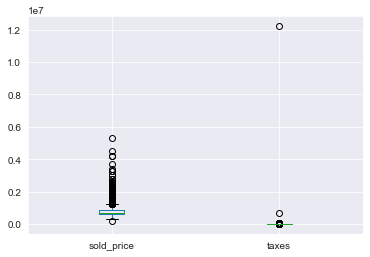

In [114]:
new_df[['sold_price','taxes']].plot.box()

<AxesSubplot:title={'center':'Taxes Distribution'}, ylabel='Frequency'>

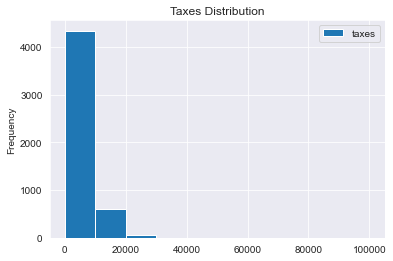

In [89]:
new_df[['taxes']].plot.hist(range=[0,  100000], title = 'Taxes Distribution')

In [82]:
corr = data[['taxes','sold_price','bedrooms','year_built']].corr()
corr.style.background_gradient(cmap='coolwarm').set_precision(2)

,taxes,sold_price,bedrooms,year_built
taxes,1.00,0.02,0.01,0.00
sold_price,0.02,1.00,0.12,-0.01
bedrooms,0.01,0.12,1.00,-0.09
year_built,0.00,-0.01,-0.09,1.00


In [92]:
corr = data[['sold_price','lot_acres','bedrooms','year_built']].corr()
corr.style.background_gradient(cmap='coolwarm').set_precision(2)

,sold_price,lot_acres,bedrooms,year_built
sold_price,1.00,0.33,0.12,-0.01
lot_acres,0.33,1.00,0.07,-0.04
bedrooms,0.12,0.07,1.00,-0.09
year_built,-0.01,-0.04,-0.09,1.00


<AxesSubplot:title={'center':'Lot acres vs Sold price'}, xlabel='lot_acres', ylabel='sold_price'>

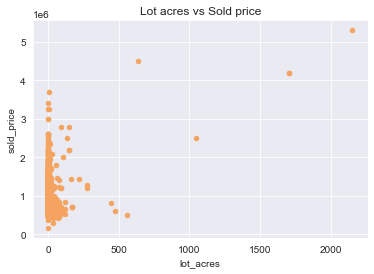

In [93]:
new_df.plot.scatter(x = 'lot_acres', y = 'sold_price',
                  color = 'sandybrown', title = 'Lot acres vs Sold price')

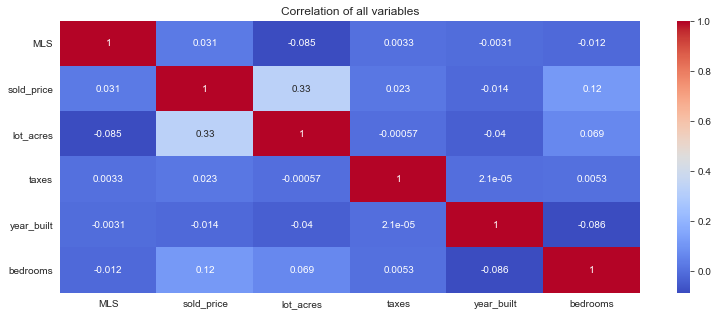

In [98]:
data2=new_df.corr()
plt.figure(figsize=(13,5))
plt.title("Correlation of all variables")
dataplot2=sns.heatmap(data2, cmap="coolwarm", annot=True)

<AxesSubplot:title={'center':'Sold price'}, ylabel='Frequency'>

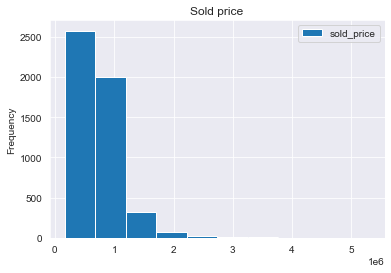

In [100]:
new_df[['sold_price']].plot.hist(title = 'Sold price')

<AxesSubplot:title={'center':'Lot acres distribution'}, ylabel='Frequency'>

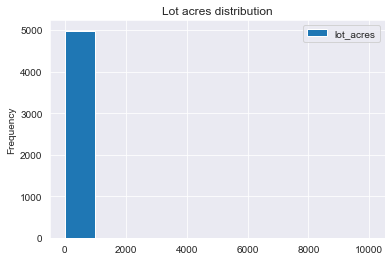

In [107]:
new_df[['lot_acres']].plot.hist(title = 'Lot acres distribution')

In [108]:
min(lot_acres)

NameError: name 'lot_acres' is not defined

In [110]:
new_df.min(axis=None, skipna=None, level=None, numeric_only=None)

MLS                                                           3042851
sold_price                                                     169000
lot_acres                                                           0
taxes                                                               0
year_built                                                          0
bedrooms                                                            1
bathrooms                                                           1
sqrt_ft                                                         10258
garage                                                              0
kitchen_features    # of Ovens: 1, Dishwasher, Freezer, Garbage Di...
fireplaces                                                           
floor_covering                                                 Carpet
HOA                                                                 0
dtype: object

In [111]:
new_df.max(axis=None, skipna=None, level=None, numeric_only=None)

MLS                                    21928565
sold_price                              5.3e+06
lot_acres                                  2154
taxes                               1.22151e+07
year_built                                 2019
bedrooms                                     36
bathrooms                                  None
sqrt_ft                                    None
garage                                     None
kitchen_features                        Wet Bar
fireplaces                                    9
floor_covering      Wood, Other: porcelain tile
HOA                                        None
dtype: object

<AxesSubplot:>

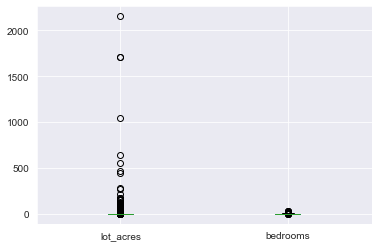

In [119]:
new_df[['lot_acres','bedrooms']].plot.box()

<AxesSubplot:title={'center':'lot acres vs bedrooms'}, xlabel='lot_acres', ylabel='bedrooms'>

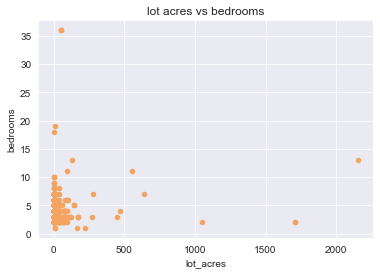

In [122]:
data.plot.scatter(x = 'lot_acres', y = 'bedrooms',
                  color = 'sandybrown', title = 'lot acres vs bedrooms')

<AxesSubplot:title={'center':'bathrooms vs bedrooms'}, xlabel='bathrooms', ylabel='bedrooms'>

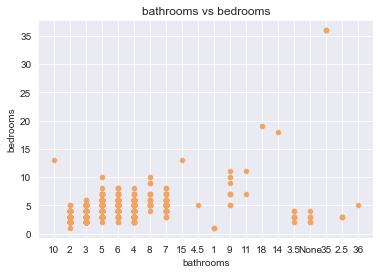

In [123]:
data.plot.scatter(x = 'bathrooms', y = 'bedrooms',
                  color = 'sandybrown', title = 'bathrooms vs bedrooms')

<AxesSubplot:title={'center':'lot acres vs bathrooms'}, xlabel='lot_acres', ylabel='bathrooms'>

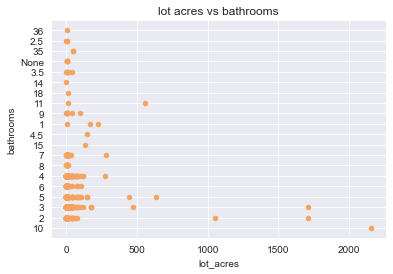

In [124]:
data.plot.scatter(x = 'lot_acres', y = 'bathrooms',
                  color = 'sandybrown', title = 'lot acres vs bathrooms')

In [129]:
to_remove=new_df[new_df['year_built']==0]
#to_remove

In [130]:
print(to_remove)

           MLS  sold_price  lot_acres    taxes  year_built  bedrooms  \
35    21307177   2495000.0     131.00  1220.32           0        13   
162   21207587   1210520.0       0.33  1412.75           0         4   
946   21608590    695000.0      72.00  2480.58           0         4   
1438  21702126    877170.0       0.60  2005.57           0         3   
1767  21719857    700000.0       0.13  7059.56           0         3   

     bathrooms sqrt_ft garage  \
35          15   13000      0   
162          5    3334      2   
946          4    2272      2   
1438         4    3078      3   
1767         3    2500      3   

                                       kitchen_features fireplaces  \
35    Compactor, Dishwasher, Freezer, Garbage Dispos...          4   
162           Dishwasher, Refrigerator, Microwave, Oven          3   
946                      Dishwasher, Refrigerator, Oven          2   
1438      Dishwasher, Garbage Disposal, Microwave, Oven          0   
1767  Dishwasher, 

In [131]:
len(to_remove)

5

In [138]:
new_df.drop(new_df[new_df['year_built']== 0].index, inplace=True)


In [136]:
plt.figure(figsize=(18,7))

<Figure size 1296x504 with 0 Axes>

<Figure size 1296x504 with 0 Axes>

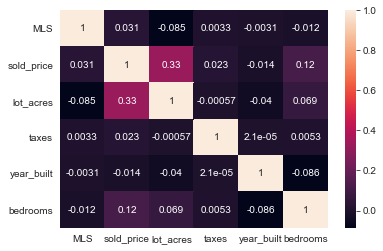

In [137]:
cor=sns.heatmap(new_df.corr(), annot=True)

In [140]:
new_df.year_built.unique

<bound method Series.unique of 0       1941
1       1997
2       1997
3       1930
4       1995
5       1999
6       2001
7       2011
8       2002
9       2007
10      1935
11      2009
12      1995
13      2015
14      2008
15      2008
16      2002
17      2010
18      2008
19      1983
20      2008
21      2001
22      2005
23      1936
24      1998
25      2004
26      2008
27      2007
28      1997
29      1985
30      2018
31      2019
32      2002
33      2010
34      2000
36      1935
37      2002
38      1935
39      1935
40      2012
41      2009
42      2008
43      2012
44      2018
45      2002
46      2018
47      2016
48      2008
49      2003
50      2002
51      1954
52      2002
53      2008
54      2003
55      1997
56      2002
57      1994
58      2014
59      2004
60      2017
61      1967
62      1995
63      2013
64      2008
65      1994
66      2004
67      2001
68      2004
69      2002
70      2018
71      2013
72      1943
73      2019
74      2009
75     

In [141]:
new_df.drop(new_df[new_df['sqrt_ft']== 0].index, inplace=True)

In [143]:
new_df.sqrt_ft.unique

<bound method Series.unique of 0        10500
1         7300
2         None
3         9019
4         6396
5         6842
6        12025
7         8921
8         5238
9         6480
10        5067
11        7230
12        6454
13        5826
14        3095
15        3095
16        7756
17        5338
18        3095
19        6050
20        3095
21        7471
22        6356
23        5645
24        4651
25        8110
26        3095
27        5391
28        7132
29        2895
30        6083
31        5767
32        5333
33        6226
34        6224
36        7569
37        5333
38        4317
39        4963
40        4724
41        6755
42        7831
43        7150
44        5550
45        7280
46        4850
47        6202
48        7182
49        1999
50        6800
51        5042
52        6622
53        2729
54        9630
55        7132
56        5795
57        4907
58        3276
59        8265
60        6107
61        3969
62        2681
63        3140
64        5349
65       

In [144]:
new_df.drop(new_df[new_df['sqrt_ft']== 'None'].index, inplace=True)

In [145]:
new_df.sqrt_ft.unique

<bound method Series.unique of 0        10500
1         7300
3         9019
4         6396
5         6842
6        12025
7         8921
8         5238
9         6480
10        5067
11        7230
12        6454
13        5826
14        3095
15        3095
16        7756
17        5338
18        3095
19        6050
20        3095
21        7471
22        6356
23        5645
24        4651
25        8110
26        3095
27        5391
28        7132
29        2895
30        6083
31        5767
32        5333
33        6226
34        6224
36        7569
37        5333
38        4317
39        4963
40        4724
41        6755
42        7831
43        7150
44        5550
45        7280
46        4850
47        6202
48        7182
49        1999
50        6800
51        5042
52        6622
53        2729
54        9630
55        7132
56        5795
57        4907
58        3276
59        8265
60        6107
61        3969
62        2681
63        3140
64        5349
65        6677
66       

In [151]:
new_df.drop(new_df[new_df['taxes']== 0].index, inplace=True)

In [152]:
new_df.max(axis=None, skipna=None, level=None, numeric_only=None)

MLS                                    21928565
sold_price                              5.3e+06
lot_acres                                  2154
taxes                               1.22151e+07
year_built                                 2019
bedrooms                                     36
bathrooms                                     9
sqrt_ft                                    9858
garage                                     None
kitchen_features                        Wet Bar
fireplaces                                    9
floor_covering      Wood, Other: porcelain tile
HOA                                        None
dtype: object

In [153]:
new_df.HOA.unique

<bound method Series.unique of 0            0
1            0
3         None
4           55
5          422
6            0
7          220
8          421
9       141.67
10        None
11         357
12           0
13         148
14      20,000
15           0
16         142
17         173
18           0
19         167
20           0
21         123
22         421
23           0
24         300
25         194
26       1,717
27         342
28         422
29           0
30         240
31         437
32         112
33         199
34         357
36           0
37         178
38           0
39        None
40         550
41         258
42           0
43         188
44         169
45         124
46         550
47         220
48         320
49        None
50         142
51           0
52         213
53      20,000
54         421
55         422
56         153
57         258
58         550
59         105
60          55
61        None
62        None
63         148
64         550
65         220
66       

In [154]:
new_df.drop(new_df[new_df['HOA']== 'None'].index, inplace=True)

In [155]:
new_df.HOA.unique

<bound method Series.unique of 0            0
1            0
4           55
5          422
6            0
7          220
8          421
9       141.67
11         357
12           0
13         148
14      20,000
15           0
16         142
17         173
18           0
19         167
20           0
21         123
22         421
23           0
24         300
25         194
26       1,717
27         342
28         422
29           0
30         240
31         437
32         112
33         199
34         357
36           0
37         178
38           0
40         550
41         258
42           0
43         188
44         169
45         124
46         550
47         220
48         320
50         142
51           0
52         213
53      20,000
54         421
55         422
56         153
57         258
58         550
59         105
60          55
63         148
64         550
65         220
66         422
67           0
68         159
69         142
70         193
71          69
73       

In [156]:
df['floor_covering']=df['floor_covering'].factorize()[0]+1

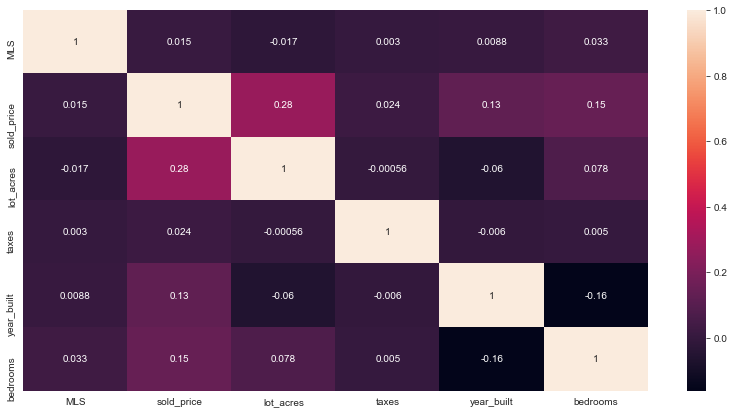

In [159]:
plt.figure(figsize=(14,7))
cor=sns.heatmap(new_df.corr(), annot=True)

In [166]:
new_df.drop(['kitchen_features'], axis=1 , inplace=True)

In [164]:
new_df

,MLS,sold_price,lot_acres,taxes,year_built,bedrooms,bathrooms,sqrt_ft,garage,kitchen_features,fireplaces,floor_covering,HOA
0,21530491,5300000.00,2154.00,5272.00,1941,13,10,10500,0,"Dishwasher, Freezer, Refrigerator, Oven",6,"Mexican Tile, Wood",0
1,21529082,4200000.00,1707.00,10422.36,1997,2,2,7300,0,"Dishwasher, Garbage Disposal",5,"Natural Stone, Other",0
4,21306357,3411450.00,3.21,15393.00,1995,4,6,6396,3,"Dishwasher, Garbage Disposal, Refrigerator, Mi...",5,"Carpet, Concrete",55
5,21528016,3250000.00,1.67,27802.84,1999,3,4,6842,3,"Dishwasher, Garbage Disposal, Refrigerator, Mi...",5,"Natural Stone, Wood, Other",422
6,21610478,2400000.00,2.10,19038.42,2001,9,8,12025,4,"Dishwasher, Garbage Disposal, Oven",6,"Carpet, Natural Stone, Wood, Other",0
7,21211741,2500000.00,1.07,21646.00,2011,6,8,8921,4,"Compactor, Dishwasher, Freezer, Garbage Dispos...",5,"Carpet, Natural Stone, Wood",220
8,21324646,3700000.00,6.73,25094.39,2002,5,7,5238,3,"Compactor, Dishwasher, Freezer, Garbage Dispos...",1,"Carpet, Natural Stone, Wood, Other",421
9,21812010,3250000.00,3.53,18936.11,2007,5,6,6480,3,"Dishwasher, Double Sink, Electric Range, Freez...",2,"Carpet, Concrete",141.67
11,21131956,2050000.00,1.65,24353.00,2009,5,6,7230,3,"Dishwasher, Garbage Disposal, Refrigerator, Mi...",4,"Carpet, Natural Stone, Wood",357
12,21217839,2100000.00,29.60,11723.00,1995,6,7,6454,3,"Dishwasher, Garbage Disposal, Refrigerator, Mi...",4,"Mexican Tile, Natural Stone, Wood",0


In [167]:
new_df

,MLS,sold_price,lot_acres,taxes,year_built,bedrooms,bathrooms,sqrt_ft,garage,fireplaces,floor_covering,HOA
0,21530491,5300000.00,2154.00,5272.00,1941,13,10,10500,0,6,"Mexican Tile, Wood",0
1,21529082,4200000.00,1707.00,10422.36,1997,2,2,7300,0,5,"Natural Stone, Other",0
4,21306357,3411450.00,3.21,15393.00,1995,4,6,6396,3,5,"Carpet, Concrete",55
5,21528016,3250000.00,1.67,27802.84,1999,3,4,6842,3,5,"Natural Stone, Wood, Other",422
6,21610478,2400000.00,2.10,19038.42,2001,9,8,12025,4,6,"Carpet, Natural Stone, Wood, Other",0
7,21211741,2500000.00,1.07,21646.00,2011,6,8,8921,4,5,"Carpet, Natural Stone, Wood",220
8,21324646,3700000.00,6.73,25094.39,2002,5,7,5238,3,1,"Carpet, Natural Stone, Wood, Other",421
9,21812010,3250000.00,3.53,18936.11,2007,5,6,6480,3,2,"Carpet, Concrete",141.67
11,21131956,2050000.00,1.65,24353.00,2009,5,6,7230,3,4,"Carpet, Natural Stone, Wood",357
12,21217839,2100000.00,29.60,11723.00,1995,6,7,6454,3,4,"Mexican Tile, Natural Stone, Wood",0


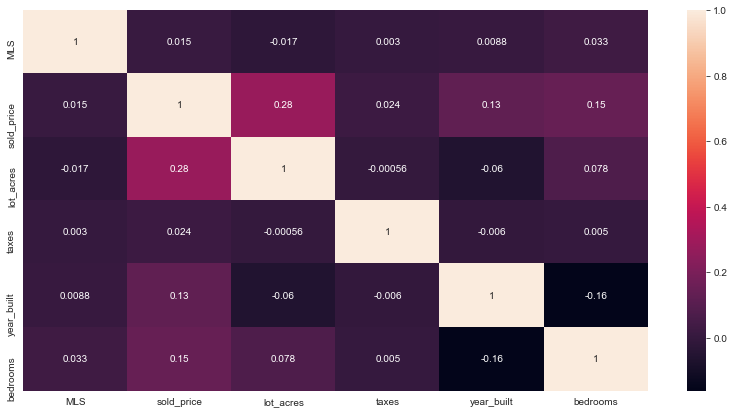

In [168]:
plt.figure(figsize=(14,7))
cor=sns.heatmap(new_df.corr(), annot=True)

In [173]:
new_df

,MLS,sold_price,lot_acres,taxes,year_built,bedrooms,bathrooms,sqrt_ft,garage,fireplaces,floor_covering,HOA
0,21530491,5300000.00,2154.00,5272.00,1941,13,10,10500,0,6,"Mexican Tile, Wood",0
1,21529082,4200000.00,1707.00,10422.36,1997,2,2,7300,0,5,"Natural Stone, Other",0
4,21306357,3411450.00,3.21,15393.00,1995,4,6,6396,3,5,"Carpet, Concrete",55
5,21528016,3250000.00,1.67,27802.84,1999,3,4,6842,3,5,"Natural Stone, Wood, Other",422
6,21610478,2400000.00,2.10,19038.42,2001,9,8,12025,4,6,"Carpet, Natural Stone, Wood, Other",0
7,21211741,2500000.00,1.07,21646.00,2011,6,8,8921,4,5,"Carpet, Natural Stone, Wood",220
8,21324646,3700000.00,6.73,25094.39,2002,5,7,5238,3,1,"Carpet, Natural Stone, Wood, Other",421
9,21812010,3250000.00,3.53,18936.11,2007,5,6,6480,3,2,"Carpet, Concrete",141.67
11,21131956,2050000.00,1.65,24353.00,2009,5,6,7230,3,4,"Carpet, Natural Stone, Wood",357
12,21217839,2100000.00,29.60,11723.00,1995,6,7,6454,3,4,"Mexican Tile, Natural Stone, Wood",0


In [177]:
new_df.corr()
#df[['sold_price','taxes']].corr()

,MLS,sold_price,lot_acres,taxes,year_built,bedrooms
MLS,1.000000,0.015423,-0.016581,0.003035,0.008763,0.032547
sold_price,0.015423,1.000000,0.282591,0.024018,0.126674,0.146744
lot_acres,-0.016581,0.282591,1.000000,-0.000561,-0.059738,0.077885
taxes,0.003035,0.024018,-0.000561,1.000000,-0.005998,0.005034
year_built,0.008763,0.126674,-0.059738,-0.005998,1.000000,-0.161259
bedrooms,0.032547,0.146744,0.077885,0.005034,-0.161259,1.000000


In [175]:
new_df

,MLS,sold_price,lot_acres,taxes,year_built,bedrooms,bathrooms,sqrt_ft,garage,fireplaces,floor_covering,HOA
0,21530491,5300000.00,2154.00,5272.00,1941,13,10,10500,0,6,"Mexican Tile, Wood",0
1,21529082,4200000.00,1707.00,10422.36,1997,2,2,7300,0,5,"Natural Stone, Other",0
4,21306357,3411450.00,3.21,15393.00,1995,4,6,6396,3,5,"Carpet, Concrete",55
5,21528016,3250000.00,1.67,27802.84,1999,3,4,6842,3,5,"Natural Stone, Wood, Other",422
6,21610478,2400000.00,2.10,19038.42,2001,9,8,12025,4,6,"Carpet, Natural Stone, Wood, Other",0
7,21211741,2500000.00,1.07,21646.00,2011,6,8,8921,4,5,"Carpet, Natural Stone, Wood",220
8,21324646,3700000.00,6.73,25094.39,2002,5,7,5238,3,1,"Carpet, Natural Stone, Wood, Other",421
9,21812010,3250000.00,3.53,18936.11,2007,5,6,6480,3,2,"Carpet, Concrete",141.67
11,21131956,2050000.00,1.65,24353.00,2009,5,6,7230,3,4,"Carpet, Natural Stone, Wood",357
12,21217839,2100000.00,29.60,11723.00,1995,6,7,6454,3,4,"Mexican Tile, Natural Stone, Wood",0
